## Визуализация графика обучения

In [1]:
import os
import numpy as np

In [2]:
val_losses = np.loadtxt('val_losses.txt')

In [3]:
n_epochs = len(val_losses)
epoch_ends = []
cur_pos = 0
for epoch in range(n_epochs):
    epoch_losses = np.loadtxt('losses_on_epoch{}.txt'.format(epoch + 1))
    if epoch == 0:
        train_losses = epoch_losses
    else:
        train_losses = np.concatenate([train_losses, epoch_losses])
    cur_pos += len(epoch_losses)
    epoch_ends.append(cur_pos)

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
def running_mean(x, n):
    cumsum = np.cumsum(x)
    return (cumsum[n:] - cumsum[:-n]) / n

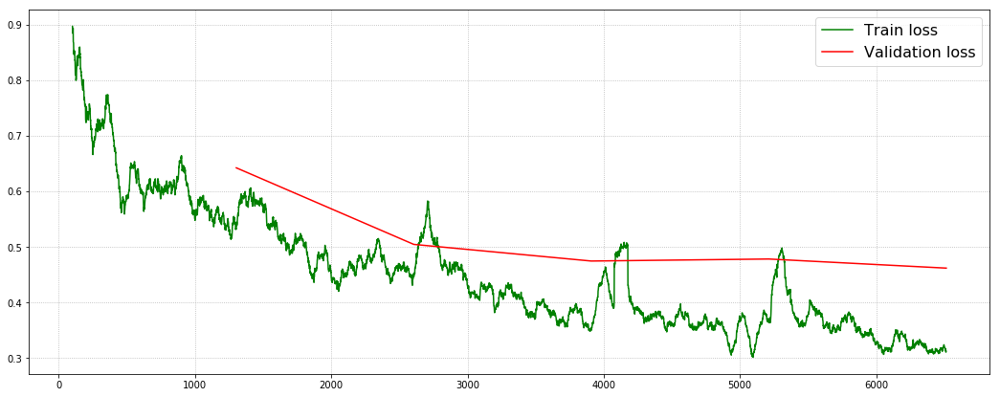

In [6]:
plt.figure(figsize=(18, 7))
plt.grid(ls=':')
plt.plot(np.arange(100, len(train_losses)), running_mean(train_losses, 100), color='g', label='Train loss')
plt.plot(epoch_ends, val_losses, color='r', label='Validation loss')
plt.legend(fontsize=16)

In [7]:
41667 // 32

1302

## Визуализация работы нейросети

In [1]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_fullsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [11]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
from keras.models import load_model
model = load_model('model_after_stage_0.hdf5')

Using TensorFlow backend.


### Обучающая выборка

In [4]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [7]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [8]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.25649523904988203


In [9]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

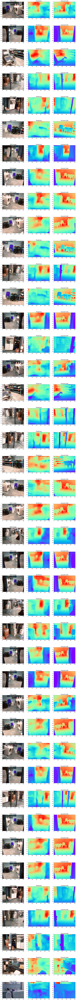

In [12]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [20]:
rgbs_val_sample = np.array(rgbs_val[::534])
depths_val_sample = np.array(depths_val[::534])

In [21]:
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

In [22]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))

validation MSE: 0.5321207336796562


In [23]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

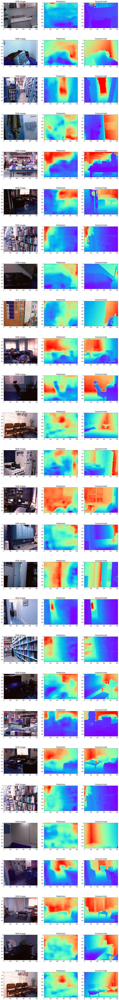

In [24]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: другие коллекции

In [ ]:
rgbs_test_sample = np.array(rgbs_test[::100])
depths_test_sample = np.array(depths_test[::100])

In [ ]:
test_prediction = model.predict(rgbs_test_sample, batch_size=32)

In [ ]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

In [ ]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [ ]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')